In [1]:
import pandas as pd 
import numpy as np
import xgboost
from xgboost import XGBClassifier
from sklearn.model_selection import train_test_split,GridSearchCV
from sklearn.metrics import accuracy_score, confusion_matrix,precision_recall_fscore_support, auc, f1_score
from sklearn.multiclass import OneVsRestClassifier
from sklearn import preprocessing
from skopt import gp_minimize
from skopt.space import Real, Integer, Dimension,Categorical
from functools import partial

import plotly.express as px
import shap
import warnings
warnings.filterwarnings('ignore')

In [2]:
train = pd.read_csv("train.csv")
test = pd.read_csv("test.csv")
train.drop(train.columns[0], axis=1, inplace=True)
test.drop(test.columns[0], axis=1, inplace=True)

In [3]:
X_train = train[train.columns[:-1]]
y_train = train[train.columns[-1]]
X_test = test[test.columns[:-1]] 
y_test = test[test.columns[-1]]


In [4]:
model = XGBClassifier(n_jobs = 6, early_stopping_rounds = 10)

In [5]:
model.fit(X_train, y_train, verbose =2)

XGBClassifier(base_score=0.5, booster=None, colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, early_stopping_rounds=10,
              gamma=0, gpu_id=-1, importance_type='gain',
              interaction_constraints=None, learning_rate=0.300000012,
              max_delta_step=0, max_depth=6, min_child_weight=1, missing=nan,
              monotone_constraints=None, n_estimators=100, n_jobs=6,
              num_parallel_tree=1, objective='multi:softprob', random_state=0,
              reg_alpha=0, reg_lambda=1, scale_pos_weight=None, subsample=1,
              tree_method=None, validate_parameters=False, verbosity=None)

In [6]:
indices = np.argsort(model.feature_importances_)[::-1]
for idx, i in enumerate(indices):
    #print("{}.\t{} - {}".format(idx, X_train.columns[i], model.feature_importances_[i]))
    if(model.feature_importances_[i] == 0.0):
        train.drop(X_train.columns[i], axis=1, inplace=True)
        test.drop(X_train.columns[i], axis=1, inplace=True)


In [7]:
model.fit(X_train, y_train, verbose =3)

XGBClassifier(base_score=0.5, booster=None, colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, early_stopping_rounds=10,
              gamma=0, gpu_id=-1, importance_type='gain',
              interaction_constraints=None, learning_rate=0.300000012,
              max_delta_step=0, max_depth=6, min_child_weight=1, missing=nan,
              monotone_constraints=None, n_estimators=100, n_jobs=6,
              num_parallel_tree=1, objective='multi:softprob', random_state=0,
              reg_alpha=0, reg_lambda=1, scale_pos_weight=None, subsample=1,
              tree_method=None, validate_parameters=False, verbosity=None)

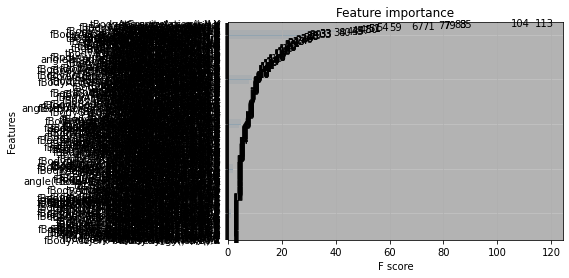

In [8]:
xgboost.plot_importance(model)
#plt.title("xgboost.plot_importance(model)")
#plt.show()
#plt.savefig('xg_mi.png', dpi = 300)

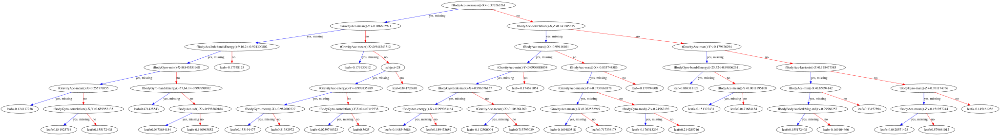

In [9]:
xgboost.to_graphviz(model, num_trees=2)

In [10]:
y_pred = model.predict(X_test)
y_pred_prop = model.predict_proba(X_test)
predictions=y_pred.copy()
conf= confusion_matrix(y_test, predictions)
Labels=list(train.Activity.unique())
pd.DataFrame(conf,columns=Labels, index=Labels)

,STANDING,SITTING,LAYING,WALKING,WALKING_DOWNSTAIRS,WALKING_UPSTAIRS
STANDING,537,0,0,0,0,0
SITTING,0,411,77,0,0,3
LAYING,0,29,503,0,0,0
WALKING,0,0,0,487,5,4
WALKING_DOWNSTAIRS,0,0,0,10,384,26
WALKING_UPSTAIRS,0,0,0,30,5,436


In [11]:
pr_rec_f_supp=precision_recall_fscore_support(y_test, predictions)
DF_report=pd.DataFrame({'Precision':list(pr_rec_f_supp[0]),
                        'Recall':list(pr_rec_f_supp[1]),
                        'F-Score':list(pr_rec_f_supp[2]),
                        'Support':list(pr_rec_f_supp[3])}, index=Labels)
DF_report

,Precision,Recall,F-Score,Support
STANDING,1.000000,1.000000,1.000000,537
SITTING,0.934091,0.837067,0.882922,491
LAYING,0.867241,0.945489,0.904676,532
WALKING,0.924099,0.981855,0.952102,496
WALKING_DOWNSTAIRS,0.974619,0.914286,0.943489,420
WALKING_UPSTAIRS,0.929638,0.925690,0.927660,471


In [12]:
X_test_new = X_test[::5]
explainer = shap.TreeExplainer(model)
shap_values = explainer.shap_values(X_test_new)
print(len(explainer.expected_value))
print(len(shap_values))

6
6


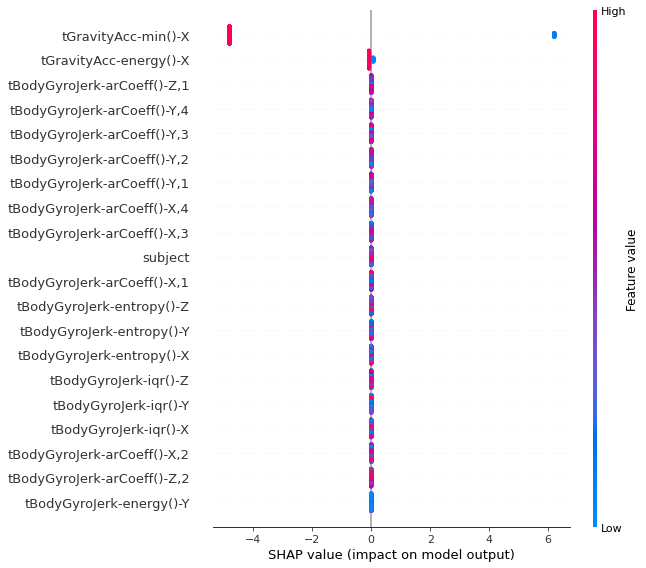

In [13]:
shap.summary_plot(shap_values[0], X_test_new)

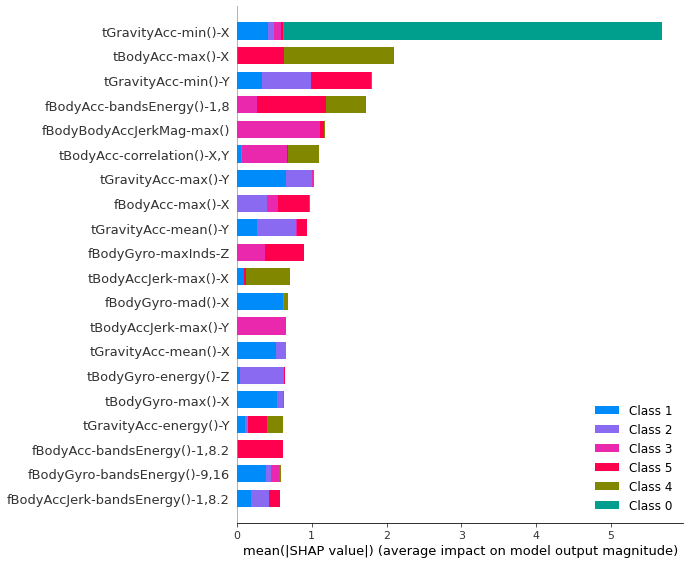

In [14]:
shap.summary_plot(shap_values, X_test)

In [15]:
model = OneVsRestClassifier(XGBClassifier(n_jobs = 6, early_stopping_rounds = 10))

In [16]:
y_train_bin = preprocessing.label_binarize(y_train, classes=[0, 1, 2, 3])
parameters = {'estimator__nthread':[6], #when use hyperthread, xgboost may become slower
              'estimator__objective':['multi:softprob'],
              'estimator__learning_rate': [0.05,0.1,0.2,0.3,0.01], #so called `eta` value
              'estimator__max_depth': [6,5,4,3,2,1],
              'estimator__min_child_weight': [11,12,13,14,15,16],
              'estimator__subsample': [0.8],
              'estimator__colsample_bytree': [0.7],
              'estimator__n_estimators': [5,100], #number of trees, change it to 1000 for better results
             }


clf = GridSearchCV(model, parameters, n_jobs=5,scoring = 'f1_samples',verbose=1, refit=True, return_train_score = True)

In [17]:
clf.fit(X_train, y_train_bin)

Fitting 5 folds for each of 360 candidates, totalling 1800 fits


[Parallel(n_jobs=5)]: Using backend LokyBackend with 5 concurrent workers.
[Parallel(n_jobs=5)]: Done  45 tasks      | elapsed:    2.2s
[Parallel(n_jobs=5)]: Done 635 tasks      | elapsed:    9.4s
[Parallel(n_jobs=5)]: Done 1635 tasks      | elapsed:   21.9s
[Parallel(n_jobs=5)]: Done 1791 out of 1800 | elapsed:   23.6s remaining:    0.1s
[Parallel(n_jobs=5)]: Done 1800 out of 1800 | elapsed:   23.8s finished


GridSearchCV(cv=None, error_score=nan,
             estimator=OneVsRestClassifier(estimator=XGBClassifier(base_score=None,
                                                                   booster=None,
                                                                   colsample_bylevel=None,
                                                                   colsample_bynode=None,
                                                                   colsample_bytree=None,
                                                                   early_stopping_rounds=10,
                                                                   gamma=None,
                                                                   gpu_id=None,
                                                                   importance_type='gain',
                                                                   interaction_constraints=None,
                                                                   learning_rate=None

In [18]:
print(getattr(clf, 'best_estimator_', None))

OneVsRestClassifier(estimator=XGBClassifier(base_score=None, booster=None,
                                            colsample_bylevel=None,
                                            colsample_bynode=None,
                                            colsample_bytree=0.7,
                                            early_stopping_rounds=10,
                                            gamma=None, gpu_id=None,
                                            importance_type='gain',
                                            interaction_constraints=None,
                                            learning_rate=0.05,
                                            max_delta_step=None, max_depth=6,
                                            min_child_weight=11, missing=nan,
                                            monotone_constraints=None,
                                            n_estimators=5, n_jobs=6, nthread=6,
                                            num_parallel_tree=None,
   

In [97]:

space = [
    Real(0.6, 0.7, name="colsample_bylevel"),
    Real(0.6, 0.7, name="colsample_bytree"),
    Real(0.01, 1, name="gamma"),
    Real(0.0001, 1, name="learning_rate"),
    Real(0.1, 10, name="max_delta_step"),
    Integer(6, 15, name="max_depth"),
    Real(10, 500, name="min_child_weight"),
    Integer(10, 100, name="n_estimators"),
    Real(0.1, 100, name="reg_alpha"),
    Real(0.1, 100, name="reg_lambda"),
    Real(0.4, 0.7, name="subsample"),
    Categorical(('multi:softprob',))
]

In [108]:
def return_model_assessment(args, X_train, y_train, X_test):
    global models, train_scores, test_scores, curr_model_hyper_params
    params = {curr_model_hyper_params[i]: args[i] for i, j in enumerate(curr_model_hyper_params)}
    model = XGBClassifier(random_state=42, seed=42)
    model.set_params(**params)
    fitted_model = model.fit(X_train, y_train, sample_weight=None)
    models.append(fitted_model)
    train_predictions = model.predict(X_train)
    test_predictions = model.predict(X_test)
    train_score = f1_score(train_predictions, y_train , average = 'macro')
    test_score = f1_score(test_predictions, y_test, average = 'macro')
    train_scores.append(train_score)
    test_scores.append(test_score)
    return 1 - test_score

In [109]:
models = []
train_scores = []
test_scores = []
curr_model_hyper_params = ['colsample_bylevel', 'colsample_bytree', 'gamma', 'learning_rate', 'max_delta_step',
                        'max_depth', 'min_child_weight', 'n_estimators', 'reg_alpha', 'reg_lambda', 'subsample']
objective_function = partial(return_model_assessment, X_train=X_train, y_train=y_train, X_test=X_test)

# running the algorithm
n_calls = 50 # number of times you want to train your model
results = gp_minimize(objective_function, space, base_estimator=None, n_calls=50, n_random_starts=n_calls-1, random_state=42, verbose = True, n_jobs =3)

Iteration No: 1 started. Evaluating function at random point.
Iteration No: 1 ended. Evaluation done at random point.
Time taken: 8.0201
Function value obtained: 0.1116
Current minimum: 0.1116
Iteration No: 2 started. Evaluating function at random point.
Iteration No: 2 ended. Evaluation done at random point.
Time taken: 23.1906
Function value obtained: 0.1014
Current minimum: 0.1014
Iteration No: 3 started. Evaluating function at random point.
Iteration No: 3 ended. Evaluation done at random point.
Time taken: 8.8855
Function value obtained: 0.1419
Current minimum: 0.1014
Iteration No: 4 started. Evaluating function at random point.
Iteration No: 4 ended. Evaluation done at random point.
Time taken: 12.2287
Function value obtained: 0.0906
Current minimum: 0.0906
Iteration No: 5 started. Evaluating function at random point.
Iteration No: 5 ended. Evaluation done at random point.
Time taken: 9.1672
Function value obtained: 0.1132
Current minimum: 0.0906
Iteration No: 6 started. Evaluati

In [110]:
metrics = pd.DataFrame(train_scores + test_scores)
metrics.loc[:,'dataset'] = ["train_score"]*n_calls + ["test_score"]*n_calls
metrics.loc[:,'Iteration Number'] = list(range(1,n_calls+1)) + list(range(1,n_calls+1))
metrics.columns = ["F1 Score", "dataset", "Iteration Number"]
fig = px.line(metrics, x="Iteration Number", y="F1 Score", color="dataset")
fig.show()

In [19]:
model_best = XGBClassifier(base_score=None, booster=None,
                                            colsample_bylevel=None,
                                            colsample_bynode=None,
                                            colsample_bytree=0.7,
                                            early_stopping_rounds=10,
                                            gamma=None, gpu_id=None,
                                            importance_type='gain',
                                            interaction_constraints=None,
                                            learning_rate=0.05,
                                            max_delta_step=None, max_depth=6,
                                            min_child_weight=11,
                                            monotone_constraints=None,
                                            n_estimators=5, n_jobs=6, nthread=6,
                                            num_parallel_tree=None,
                                            objective='multi:softprob',
                                            random_state=None, reg_alpha=None,
                                            reg_lambda=None,
                                            scale_pos_weight=None,
                                            subsample=0.8, tree_method=None,
                                            validate_parameters=False,
                                            verbosity=None)
                        

In [20]:
model_best.fit(X_train, y_train, verbose =3)

XGBClassifier(base_score=0.5, booster=None, colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=0.7,
              early_stopping_rounds=10, gamma=0, gpu_id=-1,
              importance_type='gain', interaction_constraints=None,
              learning_rate=0.05, max_delta_step=0, max_depth=6,
              min_child_weight=11, missing=nan, monotone_constraints=None,
              n_estimators=5, n_jobs=6, nthread=6, num_parallel_tree=1,
              objective='multi:softprob', random_state=0, reg_alpha=0,
              reg_lambda=1, scale_pos_weight=None, subsample=0.8,
              tree_method=None, validate_parameters=False, verbosity=None)

In [21]:
X_test_new = X_test[::5]
explainer = shap.TreeExplainer(model_best)
shap_values = explainer.shap_values(X_test_new)
print(len(explainer.expected_value))
print(len(shap_values))

6
6


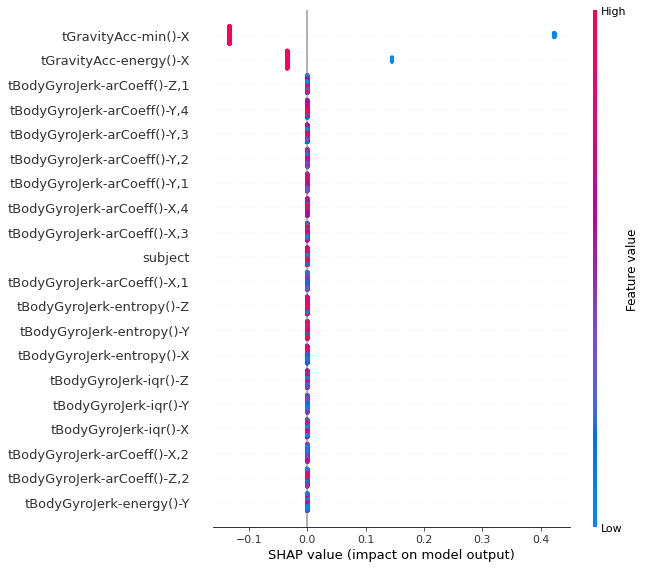

In [22]:
shap.summary_plot(shap_values[0], X_test_new)

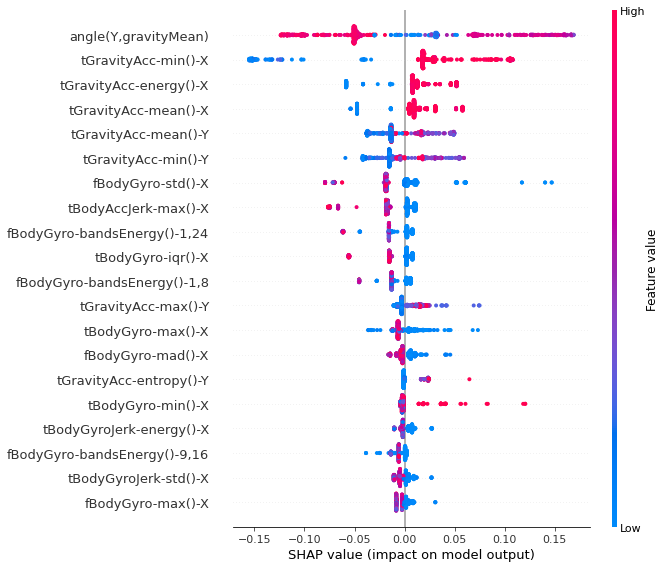

In [23]:
shap.summary_plot(shap_values[1], X_test_new)

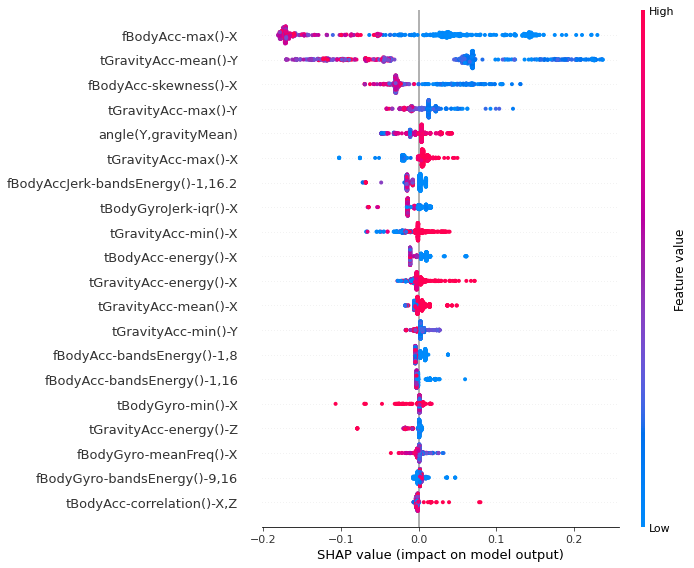

In [24]:
shap.summary_plot(shap_values[2], X_test_new)

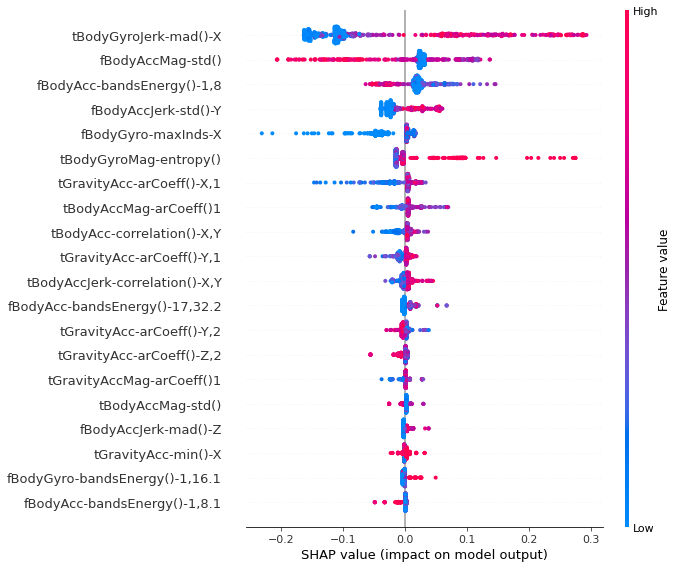

In [25]:
shap.summary_plot(shap_values[3], X_test_new)

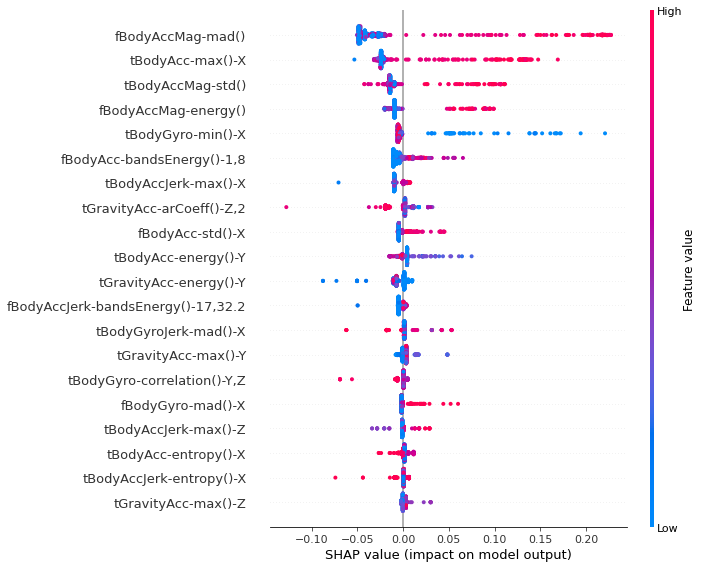

In [26]:
shap.summary_plot(shap_values[4], X_test_new)

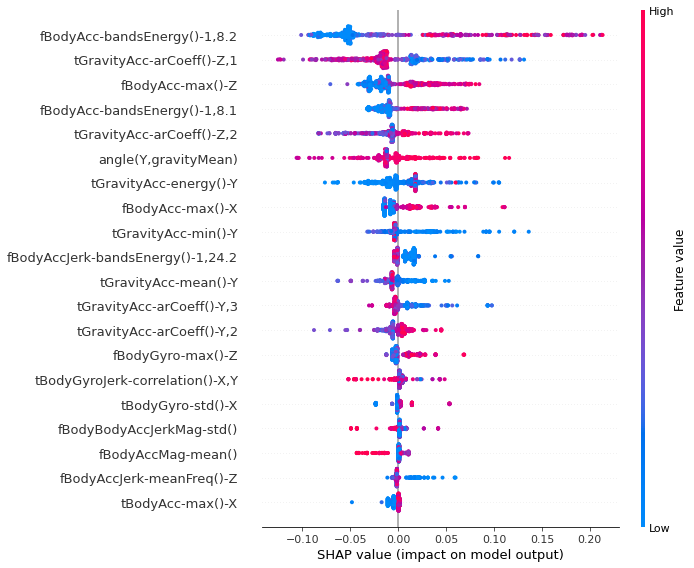

In [27]:
shap.summary_plot(shap_values[5], X_test_new)

In [28]:
y_pred = model_best.predict(X_test)
y_pred_prop = model_best.predict_proba(X_test)
predictions2=y_pred.copy()
conf= confusion_matrix(y_test, predictions)
Labels=list(train.Activity.unique())
pd.DataFrame(conf,columns=Labels, index=Labels)

,STANDING,SITTING,LAYING,WALKING,WALKING_DOWNSTAIRS,WALKING_UPSTAIRS
STANDING,537,0,0,0,0,0
SITTING,0,411,77,0,0,3
LAYING,0,29,503,0,0,0
WALKING,0,0,0,487,5,4
WALKING_DOWNSTAIRS,0,0,0,10,384,26
WALKING_UPSTAIRS,0,0,0,30,5,436


In [29]:
pr_rec_f_supp=precision_recall_fscore_support(y_test, predictions2)
DF_report=pd.DataFrame({'Precision':list(pr_rec_f_supp[0]),
                        'Recall':list(pr_rec_f_supp[1]),
                        'F-Score':list(pr_rec_f_supp[2]),
                        'Support':list(pr_rec_f_supp[3])}, index=Labels)
DF_report

,Precision,Recall,F-Score,Support
STANDING,1.000000,1.000000,1.000000,537
SITTING,0.824847,0.824847,0.824847,491
LAYING,0.844402,0.836466,0.840415,532
WALKING,0.897338,0.951613,0.923679,496
WALKING_DOWNSTAIRS,0.900000,0.878571,0.889157,420
WALKING_UPSTAIRS,0.892544,0.864119,0.878101,471


In [30]:
shap.initjs()
shap.force_plot(explainer.expected_value[1], shap_values[1])

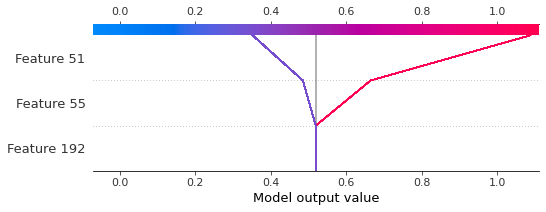

In [53]:
shap.decision_plot(explainer.expected_value[0], shap_values[0], feature_display_range=slice(None, -4, -1),ignore_warnings=True)

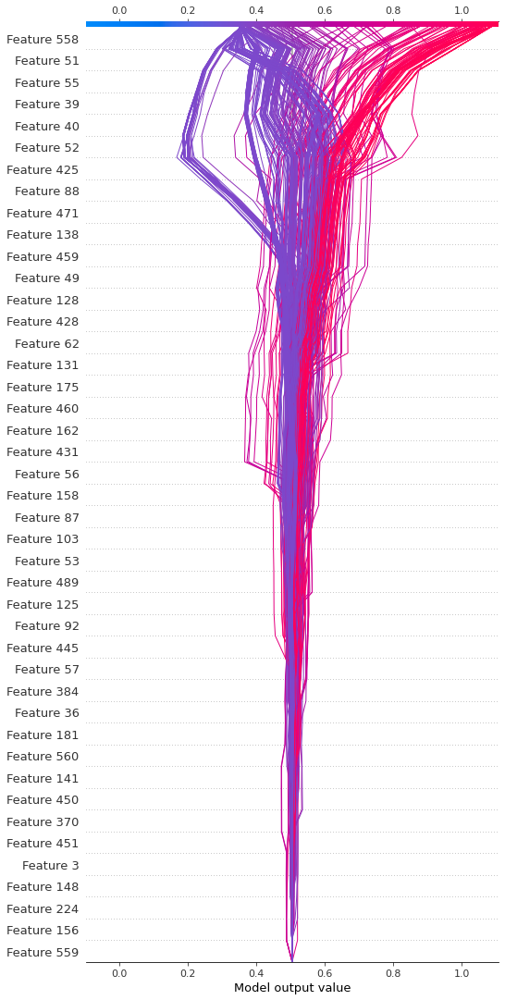

In [62]:
shap.decision_plot(explainer.expected_value[1], shap_values[1], feature_display_range=slice(None, -44, -1),ignore_warnings=True)

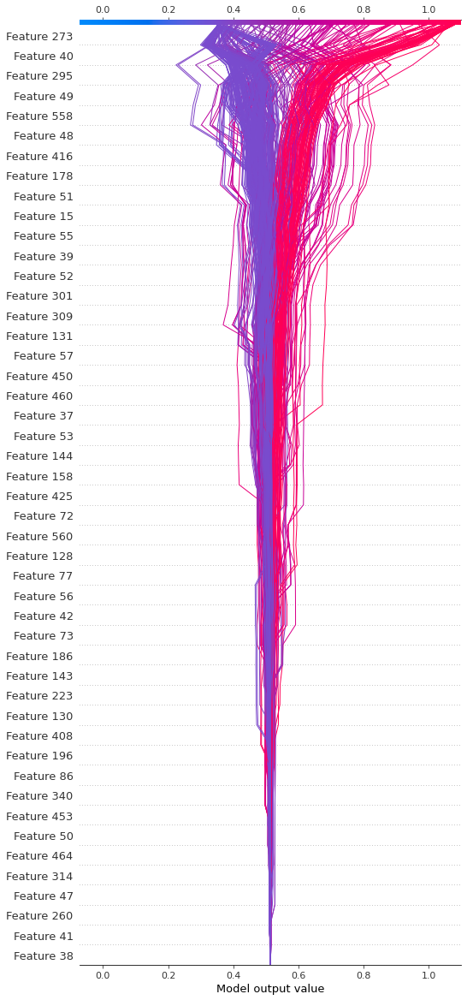

In [60]:
shap.decision_plot(explainer.expected_value[2], shap_values[2], feature_display_range=slice(None, -48, -1),ignore_warnings=True)

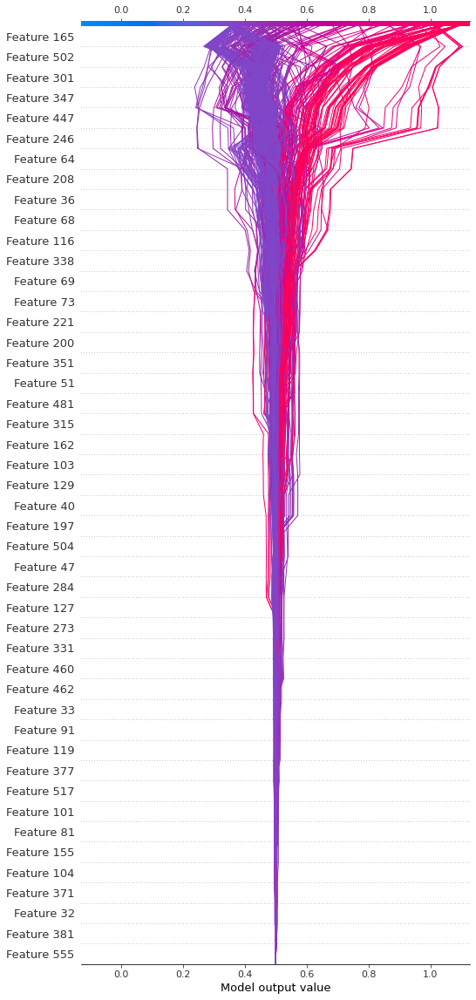

In [59]:
shap.decision_plot(explainer.expected_value[3], shap_values[3], feature_display_range=slice(None, -47, -1),ignore_warnings=True)

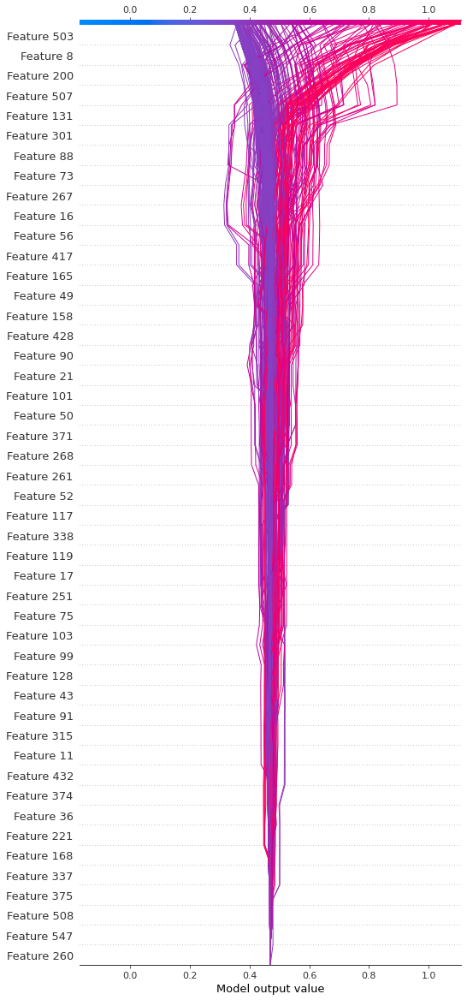

In [58]:
shap.decision_plot(explainer.expected_value[4], shap_values[4], feature_display_range=slice(None, -48, -1),ignore_warnings=True)

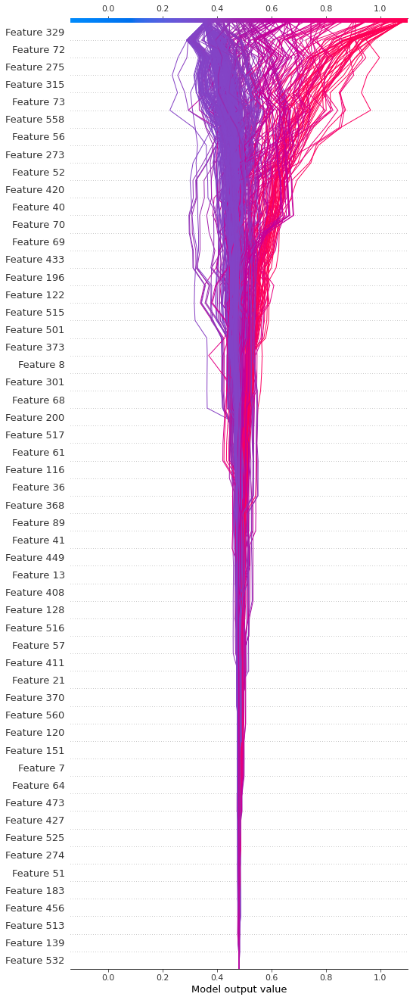

In [46]:
shap.decision_plot(explainer.expected_value[5], shap_values[5], feature_display_range=slice(None, -55, -1),ignore_warnings=True)

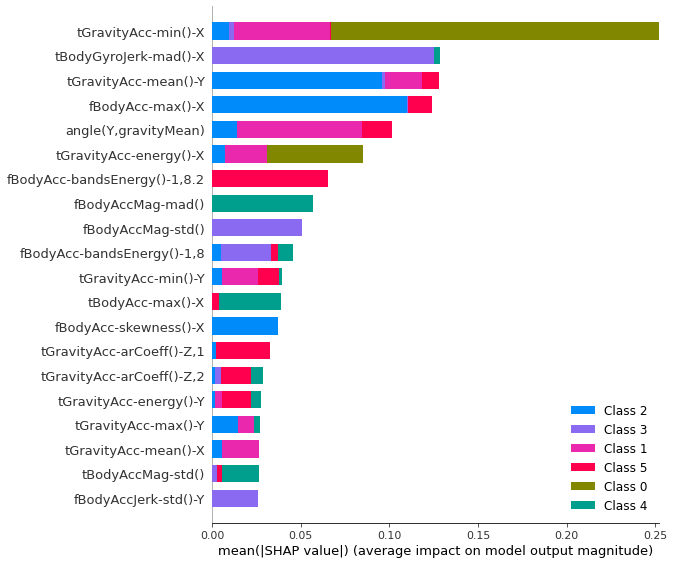

In [39]:
shap.summary_plot(shap_values, X_test)